# 経路計画（RRT族）

## 前準備

順運動学と逆運動学と可視化

In [14]:
from abc import ABC, abstractmethod
from typing import List, Tuple
import random
import time
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [15]:
# Nova2のDHパラメータ
dh_params = [
    (0, 0.2234, 0, np.pi / 2),
    (0 - np.pi / 2, 0, -0.280, 0),
    (0, 0, -0.225, 0),
    (0 - np.pi / 2, 0.1175, 0, np.pi / 2),
    (0, 0.120, 0, -np.pi / 2),
    (0, 0.088, 0, 0)
]

JOINT_LIMITS = [(-2*np.pi, 2*np.pi),
                (-np.pi, np.pi),
                (-156*np.pi/180, 156*np.pi/180),
                (-2*np.pi, 2*np.pi),
                (-2*np.pi, 2*np.pi),
                (-2*np.pi, 2*np.pi)]

# 各軸の同次変換行列
def dh_transform(theta, d, a, alpha):
    ct, st = np.cos(theta), np.sin(theta)
    ca, sa = np.cos(alpha), np.sin(alpha)
    return np.array([
        [ct, -st*ca, st*sa, a*ct],
        [st, ct*ca, -ct*sa, a*st],
        [0, sa, ca, d],
        [0, 0, 0, 1]
])

# FK
def fk(q, dh_params):
    """forward kinematics

    Args:
        q : joint positions array
        dh_params : DH parameters

    Returns:
        T : Transformation matrix
    """
    T = np.eye(4)
    for i, (theta0, d, a, alpha) in enumerate(dh_params):
       T = T @ dh_transform(q[i] + theta0, d, a, alpha)
    return T

In [16]:
def skew_symmetric(w):
    return np.array([[0, -w[2], w[1]], [w[2], 0, -w[0]], [-w[1], w[0], 0]])

def exp_se3(xi):
    w, v = xi[:3], xi[3:]
    theta = np.linalg.norm(w)
    if theta < 1e-6:
        R = np.eye(3)
        V = np.eye(3)
    else:
        w_hat = w / theta
        W = skew_symmetric(w_hat)
        R = np.eye(3) + np.sin(theta) * W + (1 - np.cos(theta)) * (W @ W)
        V = np.eye(3) + (1 - np.cos(theta)) / theta * W + (theta - np.sin(theta)) / theta**2 * (W @ W)
    p = V @ v
    T = np.eye(4)
    T[:3, :3], T[:3, 3] = R, p
    return T

def log_se3(T):
    R, p = T[:3, :3], T[:3, 3]
    theta = np.arccos(np.clip((np.trace(R) - 1) / 2, -1.0, 1.0))
    if abs(theta) < 1e-6:
        w, v = np.zeros(3), p
    else:
        w_hat = (R - R.T) / (2 * np.sin(theta))
        w = theta * np.array([w_hat[2, 1], w_hat[0, 2], w_hat[1, 0]])
        W = skew_symmetric(w / theta)
        V = np.eye(3) + (1 - np.cos(theta)) / theta * W + (theta - np.sin(theta)) / theta**2 * (W @ W)
        V_inv = np.linalg.inv(V)
        v = V_inv @ p
    
    return np.concatenate([w, v])

In [17]:
def compute_jacobian_se3(q, dh_params, delta=1e-6):
    n_joints = len(q)
    J = np.zeros((6, n_joints))
    T0 = fk(q, dh_params)
    for i in range(n_joints):
        q_perturbed = q.copy()
        q_perturbed[i] += delta
        T1 = fk(q_perturbed, dh_params)
        T_error = np.linalg.inv(T0) @ T1
        xi = log_se3(T_error) / delta
        J[:, i] = xi
    return J

def clik_dls(target_T, dh_params, q_init, lambda_sq = 0.0001, max_iter=100, tol=1e-3):
    q = q_init.copy()
    q_history = [q.copy()]
    for i in range(max_iter):
        T_current = fk(q, dh_params)
        T_error = np.linalg.inv(T_current) @ target_T
        xi = log_se3(T_error)
        if np.linalg.norm(xi) < tol:
            print("IK solved!")
            return q, q_history
        J = compute_jacobian_se3(q, dh_params)
        J_pinv_dls = J.T @ np.linalg.inv(J @ J.T + lambda_sq * np.eye(6))
        dq = J_pinv_dls @ xi
        q += np.clip(dq, -0.1, 0.1)
        q_history.append(q.copy())
    print("IK not solved.")
    return q, q_history

In [18]:
# 可視化
def get_link_pos(q, dh_params):
    positions = [np.array([0,0,0])]
    T = np.eye(4)
    for i, (theta0, d, a, alpha) in enumerate(dh_params):
        T = T @ dh_transform(q[i] + theta0, d, a, alpha)
        pos = T[:3, 3].copy()
        positions.append(pos)
    return np.array(positions)

def visualize_robot(q_history, dh_params, target_p):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter([target_p[0]],[target_p[1]], [target_p[2]], color='r', label='Target')
    
    def update(frame):
        ax.cla()
        q = q_history[frame]
        positions = get_link_pos(q, dh_params)
        ax.plot(positions[:, 0], positions[:, 1], positions[:, 2], marker='o', label='Robot')
        ax.scatter([target_p[0]],[target_p[1]], [target_p[2]], color='r', label='Target')
        ax.set_xlim(-1, 1)
        ax.set_ylim(-1, 1)
        ax.set_zlim(0, 1)
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.legend()
        ax.set_title(f"Iteration: {frame}")
    ani = FuncAnimation(fig, update, frames=len(q_history), interval=200, repeat=False)
    # plt.show()
    return ani

## IK可視化

IK solved!
calc time: 0.019086360931396484


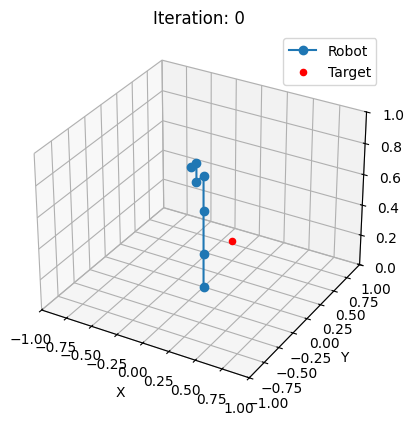

In [22]:
q_init = np.array([0.0,0,0,0,0,0])
target_T = fk(np.array([0, 0, -np.pi/2, 0, np.pi/2, np.pi/2]), dh_params)
target_p = target_T[:3, 3]
start = time.time()
q_se3, q_se3_history = clik_dls(target_T, dh_params, q_init)
stop = time.time()
print(f"calc time: {stop - start}")
ani_se3 = visualize_robot(q_se3_history, dh_params, target_p)
HTML(ani_se3.to_jshtml())

## 障害物

In [ ]:
class Obstacle(ABC):
    @abstractmethod
    def collider(self, point:np.ndarray)->bool:
        pass

class SphereObstacle(Obstacle):
    def __init__(self, center: np.ndarray, radius: float):
        self.center = center
        self.radius = radius
    
    def collider(self, point:np.ndarray)->bool:
        distance = np.linalg.norm(point - self.center)
        if distance < self.radius:
            return True
        else:
            return False

def is_collision(q, dh_params, obstacles:List[Obstacle]):
    points = get_link_pos(q, dh_params)
    for point in points:
        for obstacle in obstacles:
            if obstacle.collider(point):
                return True
    return False

## RRT

In [99]:
class Node:
    def __init__(self, q:np.ndarray, parent=None):
        self.q = q
        self.parent = parent
        
def rrt(q_start:np.ndarray, q_goal:np.ndarray, dh_params, obstacles:List[Obstacle], max_iter:int =5000, step_size:float=0.1):
    GOAL_BIAS = 0.05
    nodes = [Node(q_start)]
    for _ in  range(max_iter):
        # ランダム点またはゴールをサンプリング
        if random.random() < GOAL_BIAS:# GOAL_BIASの確立でゴールを選択
            q_rand = q_goal
        else:
            q_rand = np.array([random.uniform(lb, ub) for lb, ub in JOINT_LIMITS])
        # ノードリストの中からサンプリングした点に一番近いノードを見つける
        nearest_node = min(nodes, key=lambda node: np.linalg.norm(node.q - q_rand))
        q_nearest = nearest_node.q
        # 一番近いノードからサンプリング点にステップして新しいノードを作る
        direction = q_rand - q_nearest
        dist = np.linalg.norm(direction)
        if dist > step_size:
            q_new = q_nearest + step_size * direction / dist
        else:
            q_new = q_rand
        # 新しいノードを可動範囲内に制限
        q_new = np.clip(q_new, [lb for lb, _ in JOINT_LIMITS], [ub for _, ub in JOINT_LIMITS])
        # 新しいノードで衝突しないかチェック。衝突してなかったらノードリストに追加
        if not is_collision(q_new, dh_params, obstacles):
            new_node = Node(q_new, nearest_node)
            nodes.append(new_node)
            
            # 追加したノードがゴール十分近いかチェック
            if np.linalg.norm(q_new - q_goal) < step_size:
                # 十分近かったら親ノードをたどってパスを構築
                path = []
                current = new_node
                while current is not None:
                    path.append(current.q)
                    current = current.parent
                return path[::-1] # ゴール->スタートのリストを裏返してスタート->ゴールに
    print("Planning failed.")
    return None # max_iterでpathが見つからなかった場合

## ロボットと障害物を可視化

In [88]:
def visualize_robot_and_sphere(q_history, dh_params, target_p, sphere_obstacles:List[SphereObstacle]):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    # target
    ax.scatter([target_p[0]],[target_p[1]], [target_p[2]], color='r', label='Target')
    # obstacle
    xyzs = []
    for obs in sphere_obstacles:
        u, v = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
        x = obs.center[0] + obs.radius * np.cos(u) * np.sin(v)
        y = obs.center[1] + obs.radius * np.sin(u) * np.sin(v)
        z = obs.center[2] + obs.radius * np.cos(v)
        xyzs.append((x, y, z))
    for xyz in xyzs:
        ax.plot_surface(xyz[0], xyz[1], xyz[2], color='r', alpha=0.3)
        
    
    def update(frame):
        ax.cla()
        q = q_history[frame]
        positions = get_link_pos(q, dh_params)
        ax.plot(positions[:, 0], positions[:, 1], positions[:, 2], marker='o', label='Robot')
        ax.scatter([target_p[0]],[target_p[1]], [target_p[2]], color='r', label='Target')
        for xyz in xyzs:
            ax.plot_surface(xyz[0], xyz[1], xyz[2], color='r', alpha=0.3)
        ax.set_xlim(-1, 1)
        ax.set_ylim(-1, 1)
        ax.set_zlim(0, 1)
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.legend()
        ax.set_title(f"Iteration: {frame}")
    ani = FuncAnimation(fig, update, frames=len(q_history), interval=200, repeat=False)
    # plt.show()
    return ani

In [104]:
obstacles = [SphereObstacle(np.array([0.15, 0.0, 0.6]), 0.055),
             SphereObstacle(np.array([0.15, -0.1, 0.6]), 0.055),
             SphereObstacle(np.array([0.15, 0.1, 0.6]), 0.055),
             SphereObstacle(np.array([0.15, -0.2, 0.4]), 0.055),
             SphereObstacle(np.array([0.15, -0.2, 0.5]), 0.055),
             SphereObstacle(np.array([0.15, -0.2, 0.6]), 0.055),
             SphereObstacle(np.array([0.15, 0.2, 0.4]), 0.055),
             SphereObstacle(np.array([0.15, 0.2, 0.5]), 0.055),
             SphereObstacle(np.array([0.15, 0.2, 0.6]), 0.055)]

q_init = np.array([0.0,0,0,0,0,0])
q_init = np.array([np.pi, 0, -np.pi/2, 0, np.pi/2, np.pi/2])
target_T = fk(np.array([0, 0.05, -np.pi/2, 0, np.pi/2, np.pi/2]), dh_params)
target_p = target_T[:3, 3]
start = time.time()
q_ik, q_ik_history = clik_dls(target_T, dh_params, q_init)
stop = time.time()
print(f"ik calc time: {stop - start}")
start = time.time()
path = rrt(q_start=q_init, q_goal=q_ik, dh_params=dh_params, obstacles=obstacles, max_iter=10000, step_size=0.1)
stop = time.time()
print(f"planning calc time: {stop-start}")
if path is not None:
    ani_planning = visualize_robot_and_sphere(path, dh_params, target_p, obstacles)
HTML(ani_planning.to_jshtml())

IK solved!
ik calc time: 0.05731916427612305
Planning failed.
planning calc time: 93.16572666168213


## RRT-Connect

In [137]:
# 新しいノードを返す
def extend(tree:List[Node], q_rand:np.ndarray, dh_params, obstacles:List[Obstacle], step_size:float=0.1):
    # treeの中からランダムにサンプリングした姿勢から一番近いノードを探す。
    nearest_node = min(tree, key=lambda node: np.linalg.norm(node.q - q_rand))
    # 見つけたノードをステップサイズ分サンプリングした点に伸ばす。
    q_nearest = nearest_node.q
    direction = q_rand - q_nearest
    dist = np.linalg.norm(direction)
    if dist > step_size:
        q_new = q_nearest + step_size * direction / dist
    else:
        q_new = q_rand
    # 可動範囲でクリップ
    q_new = np.clip(q_new, [lb for lb, _ in JOINT_LIMITS], [ub for _, ub in JOINT_LIMITS])
    # 衝突してなかったらtreeに追加
    if not is_collision(q_new, dh_params, obstacles):
        new_node = Node(q_new, nearest_node)
        tree.append(new_node)
        return new_node, True
    return None, False

def rrt_connect(q_start:np.ndarray, q_goal:np.ndarray, dh_params, obstacles:List[SphereObstacle], max_iter:int=5000, step_size:float=0.3):
    tree_a = [Node(q_start)]
    tree_b = [Node(q_goal)]
    start_to_goal = True
    for i in range(max_iter):
        q_rand = np.array([random.uniform(lb, ub) for lb, ub in JOINT_LIMITS])
        # tree_aを延ばす
        new_node_a, extended = extend(tree_a, q_rand, dh_params, obstacles, step_size)
        if extended:
            # tree_aが延ばせたらtree_bがつながるか試す。
            new_node_b, connected = extend(tree_b, new_node_a.q, dh_params, obstacles, step_size)
            if connected and np.linalg.norm(new_node_a.q - new_node_b.q) < step_size:
                # つながったらpathを構築して終了
                path_a = []
                current = new_node_a
                while current is not None:
                    path_a.append(current.q)
                    current = current.parent
                path_a = path_a[::-1]
                
                path_b = []
                current = new_node_b
                while current is not None:
                    path_b.append(current.q)
                    current = current.parent
                path = path_a + path_b
                if not start_to_goal:
                    path = path[::-1]
                return path
        # 延ばせなかったりつながらなかったりしたらtree_aとtree_bを入れ替えてもう一回同じことをする。
        tree_a, tree_b = tree_b, tree_a
        start_to_goal = not start_to_goal
    print(f"Could not find path")
    return None

[ 0.4 -0.1  0.4]
IK solved!
ik calc time: 0.0264739990234375
planning calc time: 2.7405900955200195


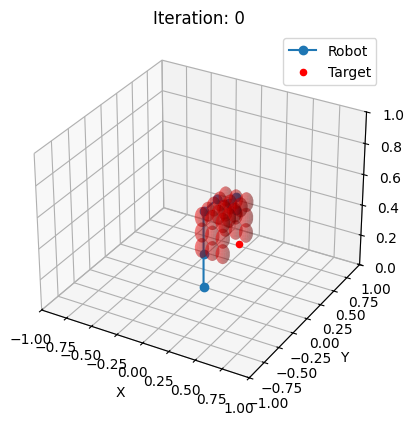

In [140]:
obstacles = [SphereObstacle(np.array([0.1, 0.0, 0.55]), 0.06),
             SphereObstacle(np.array([0.1, -0.1, 0.55]), 0.06),
             SphereObstacle(np.array([0.1, 0.1, 0.55]), 0.06),
             SphereObstacle(np.array([0.1, -0.2, 0.35]), 0.06),
             SphereObstacle(np.array([0.1, -0.2, 0.45]), 0.06),
             SphereObstacle(np.array([0.1, -0.2, 0.55]), 0.06),
             SphereObstacle(np.array([0.1, 0.2, 0.35]), 0.06),
             SphereObstacle(np.array([0.1, 0.2, 0.45]), 0.06),
             SphereObstacle(np.array([0.1, 0.2, 0.55]), 0.06),
             SphereObstacle(np.array([0.2, 0.0, 0.55]), 0.06),
             SphereObstacle(np.array([0.2, -0.1, 0.55]), 0.06),
             SphereObstacle(np.array([0.2, 0.1, 0.55]), 0.06),
             SphereObstacle(np.array([0.2, -0.2, 0.35]), 0.06),
             SphereObstacle(np.array([0.2, -0.2, 0.45]), 0.06),
             SphereObstacle(np.array([0.2, -0.2, 0.55]), 0.06),
             SphereObstacle(np.array([0.2, 0.2, 0.35]), 0.06),
             SphereObstacle(np.array([0.2, 0.2, 0.45]), 0.06),
             SphereObstacle(np.array([0.2, 0.2, 0.55]), 0.06),
             SphereObstacle(np.array([0.3, 0.0, 0.55]), 0.06),
             SphereObstacle(np.array([0.3, -0.1, 0.55]), 0.06),
             SphereObstacle(np.array([0.3, 0.1, 0.55]), 0.06),
             SphereObstacle(np.array([0.3, -0.2, 0.35]), 0.06),
             SphereObstacle(np.array([0.3, -0.2, 0.45]), 0.06),
             SphereObstacle(np.array([0.3, -0.2, 0.55]), 0.06),
             SphereObstacle(np.array([0.3, 0.2, 0.35]), 0.06),
             SphereObstacle(np.array([0.3, 0.2, 0.45]), 0.06),
             SphereObstacle(np.array([0.3, 0.2, 0.55]), 0.06)]

# q_init = np.array([0.0,0,0,0,0,0])
q_init = np.array([np.pi/2, 0, -np.pi/2, 0, np.pi/2, np.pi/2])
target_T = fk(np.array([0, 0, -np.pi/2, 0, np.pi/2, np.pi/2]), dh_params)
target_p = target_T[:3, 3]
target_p = np.array([0.40, -0.1, 0.4])
target_T[:3, 3] = target_p
print(target_p)
start = time.time()
q_ik, q_ik_history = clik_dls(target_T, dh_params, q_init)
stop = time.time()
print(f"ik calc time: {stop - start}")
start = time.time()
path = rrt_connect(q_start=q_init, q_goal=q_ik, dh_params=dh_params, obstacles=obstacles, max_iter=10000, step_size=0.1)
stop = time.time()
print(f"planning calc time: {stop-start}")
if path is not None:
    ani_planning = visualize_robot_and_sphere(path, dh_params, target_p, obstacles)
HTML(ani_planning.to_jshtml())